#  Delaware River Basin

-The Delaware River basin on the Atlantic coast of the United States  goes through five U.S. states—New York, New Jersey, Pennsylvania, Maryland, and Delaware and is the longest un-dammed river east extending 330 miles (529 km) from the Catskill Mountains in New York to the mouth of the Delaware Bay (DRBC 2004).

-The river is fed by 216 tributaries, the largest being the Schuylkill and Lehigh Rivers in Pennsylvania.

-It has an area of 14,119 square miles (36,570 km2) constituting approximately 0.4% of the land mass in the United States,draining parts of Pennsylvania (51% of the basin), New Jersey (23%), New York (18%), and Delaware (8%). 

-The Delaware Basin is covered by 55% forest, 26% agriculture, 4% wetlands, and 15% urban land.

-While the watershed is home to 7.5 million people. These bodies of water provide drinking water to 17 million people—roughly 6% of the population of the United States.

-The average annual flow rate of the Delaware is 11,700 cubic feet per second at Trenton, New Jersey.

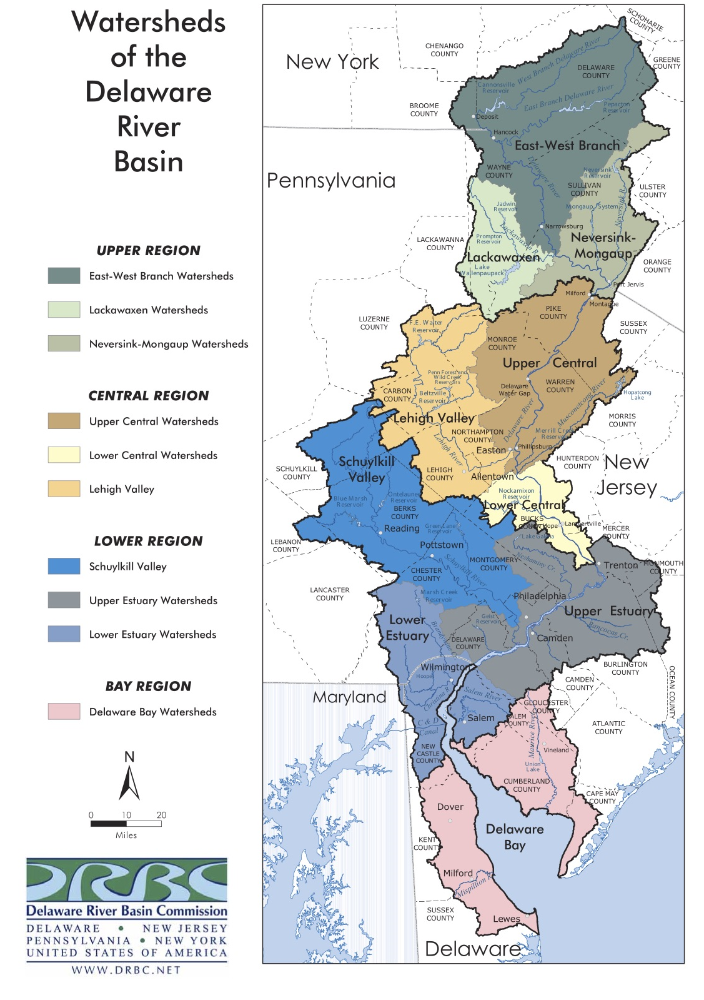

# Objective

The goal of this study is to evaluate the relationship between hydrlogical extremes and surface water quality in the Delaware river basin

In [ ]:
out_dir = "C:\\Users\\mort514\\Documents\\DRB"

setwd(out_dir)

In [ ]:
install.packages('rcpp',repos = "http://cran.us.r-project.org")

In [ ]:
#install.packages("dataRetrieval", repos = "http://cran.us.r-project.org")
#install.packages("htmlwidgets", repos = "http://cran.us.r-project.org")
#install.packages("plotly", repos = "http://cran.us.r-project.org")
#install.packages("dplyr", repos = "http://cran.us.r-project.org")
#install.packages("ggplot2", repos = "http://cran.us.r-project.org")
#install.packages("leaflet", repos = "http://cran.us.r-project.org")
#install.packages("GGally", repos = "http://cran.us.r-project.org")
#install.packages("rnoaa", repos = "http://cran.us.r-project.org")
#install.packages("shiny", repos = "http://cran.us.r-project.org")

library(plotly)
library(dplyr)
library(rgdal)
library(ggplot2)
library(dataRetrieval)
library(leaflet)
library(htmlwidgets)
library(GGally)
library (rnoaa)
library(shiny)

# Importing shapefile

In [8]:

basin_b = rgdal::readOGR(dsn="boundary", layer="drb_bnd_polygon") # DRB basin Boundary Shapefile
basin_b <- sp::spTransform(basin_b, CRS("+proj=longlat +ellps=WGS84 +datum=WGS84")) #Transformed shapefile


OGR data source with driver: ESRI Shapefile 
Source: "C:\Users\mort514\Documents\DRB\boundary", layer: "drb_bnd_polygon"
with 1 features
It has 5 fields


# Climate Data

In [6]:
# Meta data for all the noaa stations 
if(!exists("all_station_meta_data")){
all_station_meta_data = rnoaa::ghcnd_stations() }
##############################################################################################
#  Daily Precipitation data stations for DRB having atleast 20 Years of data and Still active
##############################################################################################

lat = c(38,42.5) # DRB boundary latitude
lon = c(-74.5,-76.5)# DRB boundary longitude
rl = 20 # minimum record length 
end_year = 2019 

st_prcp = all_station_meta_data %>% mutate(RL = last_year - first_year) %>% 
filter(element %in% c("PRCP") & RL>rl & last_year==end_year &
    latitude >= lat[1] & latitude <= lat[2] & longitude<= lon[1] & longitude>= lon[2] ) 

############################################################################################
#  Daily Temperature data stations for DRB having atleast 20 Years of data and Still active
############################################################################################

st_temp = all_station_meta_data %>% mutate(RL = last_year - first_year) %>% 
filter(element %in% c("TMAX") & RL>rl & 
latitude >= lat[1] & latitude <= lat[2] & longitude<= lon[1] & longitude>= lon[2])

###############################################################################################
#                        Downloading Daily Climate Data from NOAA 
###############################################################################################
if(!exists("dat_prcp")){
dat_prcp = rnoaa::meteo_pull_monitors(st_prcp$id) %>% 
  mutate(Year = as.numeric(substr(date,1,4)),M = as.numeric(substr(date,6,7)),D = as.numeric(substr(date,9,10)))}

dat_temp = dat_prcp %>% filter(id %in% st_temp$id) %>% select(id,date,Year,M,D,tmax,tmin,tobs)



file path:          C:\Users\mdrub\AppData\Local\rnoaa\rnoaa\Cache/ghcnd/US1DENC0040.dly
file last updated:  2019-05-20 15:41:25
file min/max dates: 1998-06-01 / 2019-05-31
file path:          C:\Users\mdrub\AppData\Local\rnoaa\rnoaa\Cache/ghcnd/US1DESS0035.dly
file last updated:  2019-05-20 15:41:30
file min/max dates: 1998-06-01 / 2019-05-31
file path:          C:\Users\mdrub\AppData\Local\rnoaa\rnoaa\Cache/ghcnd/US1NYBM0007.dly
file last updated:  2019-07-01 23:09:36
file min/max dates: 1998-06-01 / 2019-06-30
file path:          C:\Users\mdrub\AppData\Local\rnoaa\rnoaa\Cache/ghcnd/US1NYCR0005.dly
file last updated:  2019-05-20 15:41:38
file min/max dates: 1998-06-01 / 2019-05-31
file path:          C:\Users\mdrub\AppData\Local\rnoaa\rnoaa\Cache/ghcnd/US1NYTG0008.dly
file last updated:  2019-05-20 15:41:44
file min/max dates: 1998-06-01 / 2019-05-31
file path:          C:\Users\mdrub\AppData\Local\rnoaa\rnoaa\Cache/ghcnd/US1PABK0005.dly
file last updated:  2019-05-20 15:41:54
file m

file last updated:  2019-05-20 16:37:49
file min/max dates: 1944-07-01 / 2019-05-31
file path:          C:\Users\mdrub\AppData\Local\rnoaa\rnoaa\Cache/ghcnd/USC00360560.dly
file last updated:  2019-05-20 16:38:40
file min/max dates: 1971-09-01 / 2019-05-31
file path:          C:\Users\mdrub\AppData\Local\rnoaa\rnoaa\Cache/ghcnd/USC00360785.dly
file last updated:  2019-05-20 16:40:54
file min/max dates: 1978-05-01 / 2019-05-31
file path:          C:\Users\mdrub\AppData\Local\rnoaa\rnoaa\Cache/ghcnd/USC00361080.dly
file last updated:  2019-05-20 16:41:22
file min/max dates: 1978-12-01 / 2019-03-31
file path:          C:\Users\mdrub\AppData\Local\rnoaa\rnoaa\Cache/ghcnd/USC00361737.dly
file last updated:  2019-05-20 16:43:57
file min/max dates: 1923-08-01 / 2019-05-31
file path:          C:\Users\mdrub\AppData\Local\rnoaa\rnoaa\Cache/ghcnd/USC00362323.dly
file last updated:  2019-05-20 16:45:15
file min/max dates: 1948-05-01 / 2019-04-30
file path:          C:\Users\mdrub\AppData\Local\rn

file path:          C:\Users\mdrub\AppData\Local\rnoaa\rnoaa\Cache/ghcnd/USW00093730.dly
file last updated:  2019-05-24 12:18:02
file min/max dates: 1947-01-01 / 2019-05-31
file path:          C:\Users\mdrub\AppData\Local\rnoaa\rnoaa\Cache/ghcnd/USW00093780.dly
file last updated:  2019-05-24 12:18:21
file min/max dates: 1997-12-01 / 2019-05-31
file path:          C:\Users\mdrub\AppData\Local\rnoaa\rnoaa\Cache/ghcnd/USW00094732.dly
file last updated:  2019-05-24 12:18:36
file min/max dates: 1996-07-01 / 2019-05-31


# Water Quality Data

**Water Quality Parameters**

USGS use various codes for basic retrievals:

- site id
- parameter code ([full list](https://help.waterdata.usgs.gov/code/parameter_cd_query?fmt=rdb&inline=true&group_cd=%))

    - common codes
    
|code|name|$unit$|
|----|----|---|
|99133| NO3+NO2, water,insitu|$mg/L$
|00080|Color, water|$PCU$|
|00096|Salinity, water,unfiltered|$mg/L @25C$|
|00010|Temperature, water|$deg C$|
|00095|Specific conductance, water, unfiltered|$uS/cm @25C$|
|00300|Dissolved oxygen|$mg/L$|
|00400|pH
|00602|Total nitrogen,water, filtered|$mg/L$|
|00665|Total phosphorus,water, unfiltered|$mg/L$|
|00681|DOC|$mg/L$|
|00076|Turbidity,water,unfiltered |NTU|
|00530|Total suspended solids, water,unfiltered|$mg/L$|


- statistic code ([full list](https://help.waterdata.usgs.gov/code/stat_cd_nm_query?stat_nm_cd=%25&fmt=html))

    - common codes
    
code|name
:---:|:---:
00001|maximum
00002|minimum
00003|mean

**Meta Data of active sites with in DRB and filtered for record length**

In [ ]:
pCode_d = data.frame(parm_cd = c('00060','00010','00095','00300','00400','00602','00665','00530','00681','00618','00076'),
                     name = c('Discharge','Water Temperature','Specific conductance','Dissolved oxygen','pH','Total Nitrogen','Total Phosphorus',
                              'Total suspended solids','DOC','Nitrate','Turbidity'),
                    units = c('cfs','deg C','uS/cm @25C','mg/L','','mg/L','mg/L','mg/L','mg/L','mg/L','NTU'))

HUC1 = c("02040201","02040202", "02040203", "02040204","02040205", "02040206", "02040207", "02040101","02040102", "02040103")
HUC2 = c("02040104","02040105", "02040106")

sites1 <- readNWISdata(huc = HUC1, parameterCd = as.character(pCode_d$parm_cd), service="site", asDateTime = TRUE,
                      seriesCatalogOutput=TRUE)
sites2 <- readNWISdata(huc = HUC2, parameterCd = as.character(pCode_d$parm_cd), service="site", asDateTime = TRUE,
                     seriesCatalogOutput=TRUE)

# Filterred parameters :

rl = 15 # minimum record length 
end_year = 2019 

sites = bind_rows(sites1,sites2) %>% mutate(RL = as.numeric(substr(end_date,1,4))-as.numeric(substr(begin_date,1,4))) %>%
  filter(parm_cd %in% pCode & medium_grp_cd %in% "wat" & count_nu >= 1 & 
           !duplicated(.[c('site_no', 'parm_cd')]) & RL>=rl & substr(end_date,1,4)==end_year) %>% left_join(pCode_d)

 print(paste0('No. of Sites : ',length(unique(sites$site_no))))

write.csv(sites, paste(out_dir, "DRB_USGS_sites.csv", sep = ""))

In [22]:
dis_gage_siteNo <- c('01467200','01463500','01434000','01427510','01427207','01443500','01481000','01467000','01482500','0411500')

dis = sites %>% filter(site_no %in% dis_gage_siteNo)

In [11]:
startDate = as.Date('1980-01-01')
endDate = as.Date('2019-01-01')

wqp_dat = sites %>% select(site_no, parm_cd,name,units) %>% na.omit() %>% group_by(site_no, parm_cd,name,units) %>% 
do(readNWISqw(siteNumber = .$site_no[1], parameterCd = .$parm_cd, startDate  = startDate,  endDate = endDate))



ERROR: Error in sites %>% select(site_no, parm_cd, name, units) %>% na.omit() %>% : could not find function "%>%"


In [125]:
#sites %>% group_by(name) %>% summarise(total_sites = length(unique(site_no)))
 p = wqp_dat %>% select(Parameters=name,site_no) %>%
group_by(Parameters) %>% summarise(total_sites = length(unique(site_no))) %>%
ggplot()+
geom_col(aes(Parameters,total_sites,color = Parameters,fill = Parameters))+
xlab("Parameters")+ylab("No. of Sites")+
coord_flip()

m = ggplotly(p)

Adding missing grouping variables: `parm_cd`, `units`


In [131]:
m

HTML widgets cannot be represented in plain text (need html)

In [135]:
daily_mean_wq = wqp_dat %>% select('site_no','name','units','result_va','startDateTime') %>% 
mutate(timeStamp = substr(startDateTime,1,10))%>%
group_by(site_no,name,units,timeStamp) %>%
summarize(daily_mean = mean(result_va)) %>% na.omit()#%>% mutate(n = 1: n()) %>% 
#tidyr::spread(name,daily_mean) %>% ungroup() 

#group_by(timeStamp) %>% summarise( DOC= max(DOC,na.rm=T),Nitrate = max(Nitrate,na.rm=T),
#`Total Nitrogen`=max(`Total Nitrogen`,na.rm=T),`Total Phosphorus` =max(`Total Phosphorus`,na.rm=T))%>% ungroup() %>% 
#select(-timeStamp,-Nitrate)%>% filter_all(all_vars(!is.infinite(.)))
#ggpairs(pp)

Adding missing grouping variables: `parm_cd`


In [ ]:
sites_stat = daily_mean_wq %>% group_by(site_no) %>% do(data.frame(Parameters =unique(.$name)))

#sites_stat%>% filter(site_no = '01411400')
daily_mean_wq %>% filter(site_no == '01411400') %>% mutate(n = 1: n()) %>% 
tidyr::spread(name,daily_mean) %>% ungroup() 





# Total Maximum Daily Loads (TMDLs)

USEPA and DRBC have identified Dissolved Oxygen (DO), Total Phosphorus (TP), Total Nitrogen (TN), and Total Suspended Solids (TSS) to establish Total Maximum Daily Loads (TMDLs) in accordance with the Federal Clean Water Act. 

In [ ]:
tmdl_par =c('Dissolved oxygen','Total Phosphorus','Total Nitrogen','Total suspended solids')

tmdl_sites = daily_mean_wq %>% filter(name %in% tmdl_par) %>% 
group_by(site_no) %>% do(data.frame(Parameters =unique(.$name))) %>% summarise(n = n()) %>% filter(n==4) 

tmdl_dat = daily_mean_wq %>% ungroup() %>% filter(site_no %in% tmdl_sites$site_no & name %in% tmdl_par) %>%
mutate(Year = as.numeric(substr(timeStamp,1,4))) 

ui <- fluidPage(

    headerPanel("Total Maximum Daily Loads"),
    sidebarPanel(
        selectInput('parm', 'Parameters', choices = tmdl_par, selected = 'Dissolved oxygen')
    ),
    mainPanel(fluidRow(column(width = 9,
                          tabsetPanel(
                            tabPanel("Scatter Plot", fluidRow(column(width = 9,
      plotlyOutput('scatterPlot', height = "900px")))),
         tabPanel("Box Plot", fluidRow(column(width = 9,
      plotlyOutput('boxPlot', height = "900px")))))))
    )
)

server <- function(input, output) {

  #add reactive data information. Dataset = built in diamonds data
  dataset <- reactive({tmdl_dat %>% filter(name==input$parm)})

  output$scatterPlot <- renderPlotly({
    p <- ggplot(dataset(),aes(Year,daily_mean)) + 
      geom_point(color = "blue")+
      ylab(as.character(input$parm))+  facet_wrap(~site_no,scales = "free_y",ncol = 3)

    ggplotly(p) 
     

  })

}

shinyApp(ui, server)

In [ ]:
save.image("C:/DRB/notebook.RData")

In [ ]:
pp = daily_mean_trenton_wq %>% 
filter(timeStamp %in% t$timeStamp ) %>%  mutate(n = 1: n()) %>% 
tidyr::spread(name,daily_mean) %>% ungroup() %>% # %>% select(-site_no,-n,-timeStamp,-Nitrate,-units) %>%
group_by(timeStamp) %>% summarise( DOC= max(DOC,na.rm=T),Nitrate = max(Nitrate,na.rm=T),
`Total Nitrogen` =max(`Total Nitrogen`,na.rm=T),`Total Phosphorus` =max(`Total Phosphorus`,na.rm=T))%>% ungroup() %>% 
select(-timeStamp,-Nitrate)%>% filter_all(all_vars(!is.infinite(.)))
ggpairs(pp)

In [99]:
trenton_dis = readNWISdata(siteNumber = '01463500', parameterCd = "00060", startDate = startDate,
                       endDate = endDate, service = "dv")

In [ ]:
head(trenton_dis)

In [5]:
#library(leaflet)
m =leaflet(data=sites %>% filter(!duplicated(site_no))) %>% 
   setView(lng = -75.1, lat = 40.8, zoom = 7) %>%
  addProviderTiles("CartoDB.Positron") %>%
  addPolylines(data=basin_b, weight=2, col= 'black') %>%
  addCircleMarkers(~dec_long_va,~dec_lat_va,
                   color = "green", radius=4, stroke=FALSE,
                   fillOpacity = 0.5, opacity = 0.8,
                   popup=~site_no)
m

saveWidget(m, file=paste(out_dir, "USGS_sites_DRB.html", sep = ""))

HTML widgets cannot be represented in plain text (need html)

In [80]:
table(sites$parm_cd)



00010 00065 00095 00300 00301 00400 00530 00602 00618 00665 00681 63680 72019 
   50     2    29    28    23    27    28    29     5    28    30     1   237 

In [69]:
#sites %>% filter(parm_cd =="00530") %>% select(site_no,parm_cd,RL)
#dd =readNWISdata(sites =(sites %>% filter(parm_cd =="00530"))$site_no, service = 'dv',parameterCd ="00530",startDate = "1980-01-01",endDate = "2019-01-01")
#read_wq_daily(sites =sites$site_no[1], pc ="00010")
#unique(dat_wq_daily$parm_cd)
#dd = readNWISqw(siteNumber = (sites %>% filter(parm_cd =="00530"))$site_no, parameterCd = "00530", startDate  = "1980-01-01",  endDate = "2019-01-01")


**Daily Water Quality Data**

In [28]:
read_wq_daily<-function(sites,pc){
 df =readNWISdata(sites =sites, service = 'dv',parameterCd =pc,startDate = "1980-01-01",endDate = "2019-01-01") 
    print(dim(df)[1])
    if(dim(df)[1]!=0){
       df= df %>% select_('site_no','dateTime',
        'Val_max'=paste0('X_',pc,'_00001'),'Val_max_cd'=paste0('X_',pc,'_00001_cd'),
        'Val_min'=paste0('X_',pc,'_00002'),'Val_min_cd'=paste0('X_',pc,'_00002_cd'),
        'Val_mean'=paste0('X_',pc,'_00003'),'Val_mean_cd'=paste0('X_',pc,'_00003_cd'))
        }
    return(df)
    }

dat_wq_daily= sites %>% filter(!parm_cd %in% c("00065","63680","00618"))%>% select(site_no,parm_cd) %>% 
group_by(parm_cd) %>% do(read_wq_daily(sites =.$site_no, pc =.$parm_cd[1])) 

write.csv(dat_wq_daily,"daily_wq_DRB.csv")
                  

[1] 267789


Warning message:
"select_() is deprecated. 
Please use select() instead

The 'programming' vignette or the tidyeval book can help you
to program with select() : https://tidyeval.tidyverse.org
This warning is displayed once per session."

[1] 69607
[1] 60840
[1] 5682
[1] 61640
[1] 0
[1] 0
[1] 0
[1] 0
[1] 701734


In [23]:
sites

agency_cd,site_no,station_nm,site_tp_cd,dec_lat_va,dec_long_va,coord_acy_cd,dec_coord_datum_cd,alt_va,alt_acy_va,...,ts_id,loc_web_ds,medium_grp_cd,parm_grp_cd,srs_id,access_cd,begin_date,end_date,count_nu,RL
USGS,01411400,Fishing C at Rio Grande NJ,ST,39.02750,-74.89639,S,NAD83,NA,NA,...,0,NA,wat,PHY,1642818,0,1997-11-24,2019-02-08,80,22
USGS,01411400,Fishing C at Rio Grande NJ,ST,39.02750,-74.89639,S,NAD83,NA,NA,...,0,NA,wat,NUT,52450988,0,1997-11-24,2019-02-08,86,22
USGS,01411400,Fishing C at Rio Grande NJ,ST,39.02750,-74.89639,S,NAD83,NA,NA,...,0,NA,wat,NUT,153049,0,1997-11-24,2019-02-08,86,22
USGS,01411400,Fishing C at Rio Grande NJ,ST,39.02750,-74.89639,S,NAD83,NA,NA,...,0,NA,wat,OOT,701250,0,1997-11-24,2019-02-08,86,22
USGS,01411444,West Creek near Leesburg NJ,ST,39.26000,-74.91139,S,NAD83,NA,NA,...,0,NA,wat,PHY,1645597,0,1998-12-09,2019-02-07,95,21
USGS,01411444,West Creek near Leesburg NJ,ST,39.26000,-74.91139,S,NAD83,NA,NA,...,0,NA,wat,PHY,1646694,0,1998-12-09,2019-02-07,81,21
USGS,01411444,West Creek near Leesburg NJ,ST,39.26000,-74.91139,S,NAD83,NA,NA,...,0,NA,wat,INN,154302,0,1998-12-09,2019-02-07,78,21
USGS,01411444,West Creek near Leesburg NJ,ST,39.26000,-74.91139,S,NAD83,NA,NA,...,0,NA,wat,INN,154302,0,1998-12-09,2019-02-07,78,21
USGS,01411444,West Creek near Leesburg NJ,ST,39.26000,-74.91139,S,NAD83,NA,NA,...,0,NA,wat,PHY,17028275,0,1998-12-09,2019-02-07,80,21
USGS,01411444,West Creek near Leesburg NJ,ST,39.26000,-74.91139,S,NAD83,NA,NA,...,0,NA,wat,PHY,1642818,0,1998-12-09,2019-02-07,76,21


In [26]:
head(dat_wq_daily)

ERROR: Error in head(dat_wq_daily): object 'dat_wq_daily' not found


In [25]:

df = dat_wq_daily %>% mutate(Year = as.numeric(substr(dateTime,1,4)),Month = as.numeric(substr(dateTime,6,7)),
        Day = as.numeric(substr(dateTime,9,10))) 
head(df)

ERROR: Error in eval(lhs, parent, parent): object 'dat_wq_daily' not found


**Box-Plots**

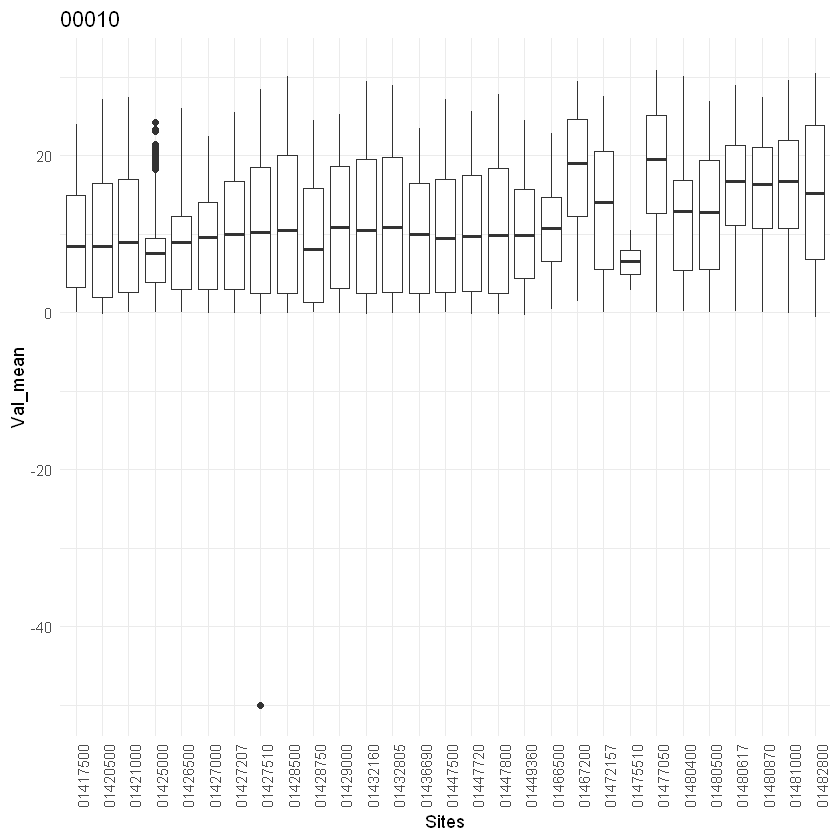

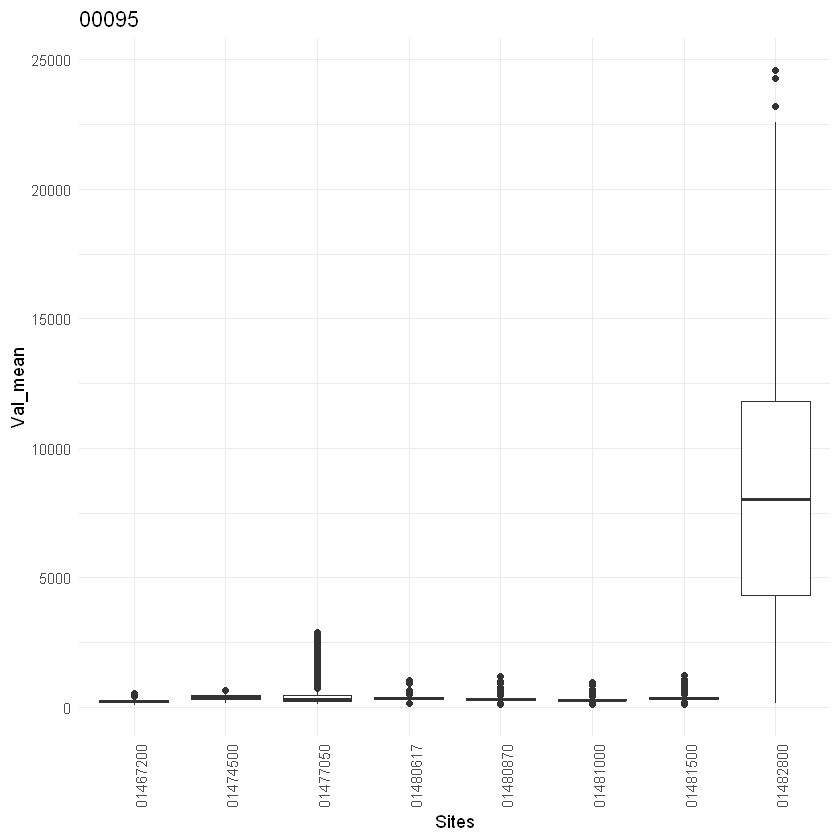

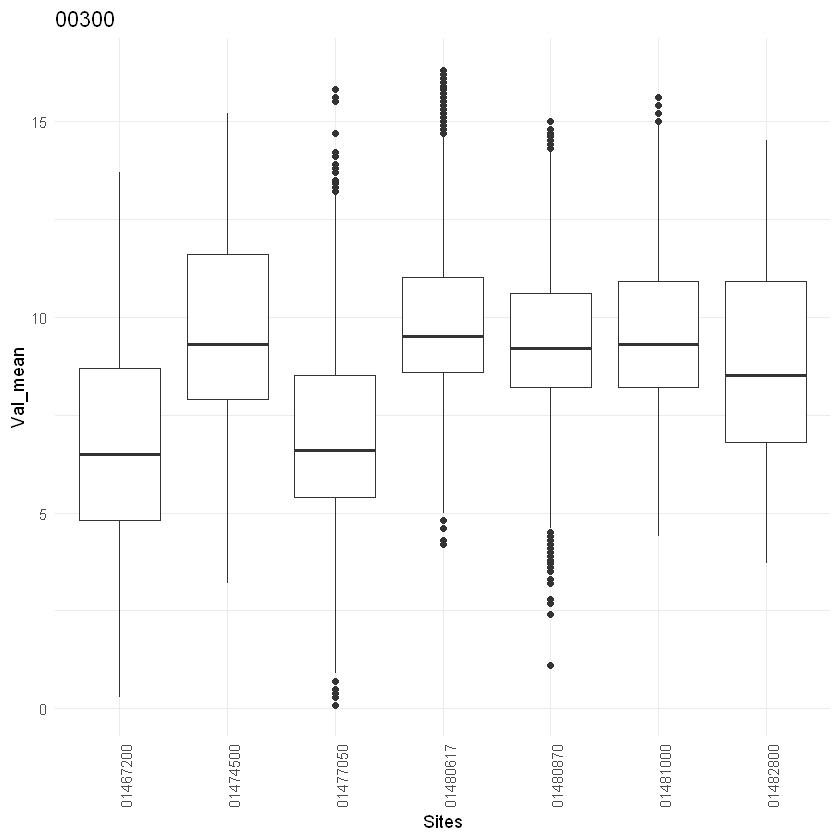

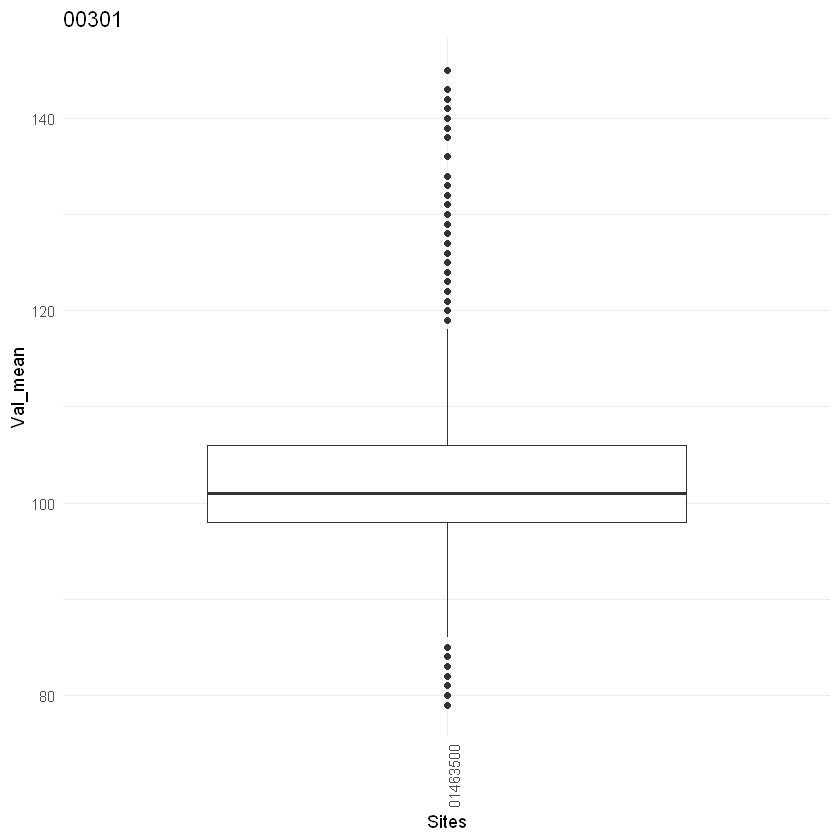

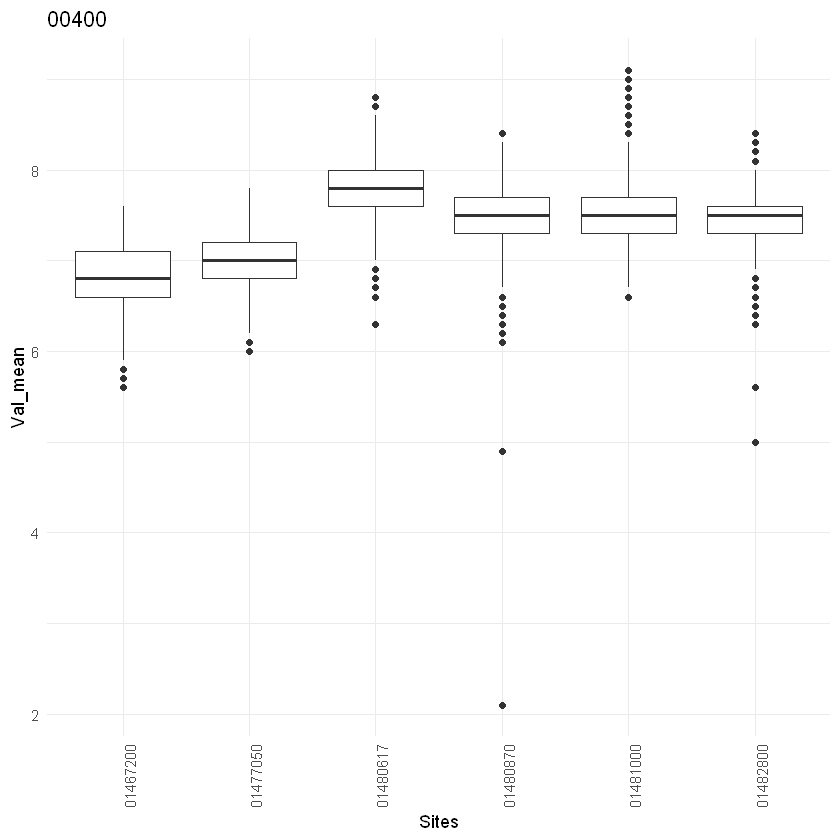

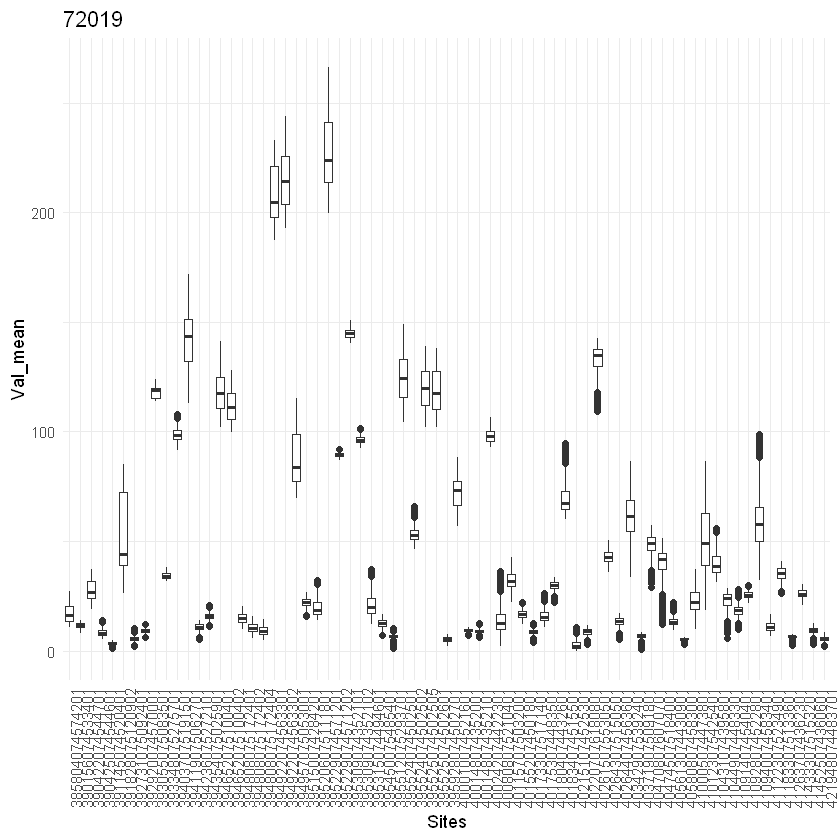

In [102]:
for(var in unique(dat_wq_daily$parm_cd)){
df = dat_wq_daily %>% filter(!is.na(Val_mean)) %>% 
            filter(parm_cd==var)
p =ggplot(df) +
geom_boxplot(aes(site_no,Val_mean))+
 theme_minimal() + theme(axis.text.x = element_text(angle = 90, hjust = 1))+
    ggtitle(paste0(unique(df$parm_cd[1])))+xlab('Sites')#+ylab(paste0(df$ResultMeasure.MeasureUnitCode[1]))
    
 print(p)
#as_widget(ggplotly(p))

}

**Time Seies Plots**

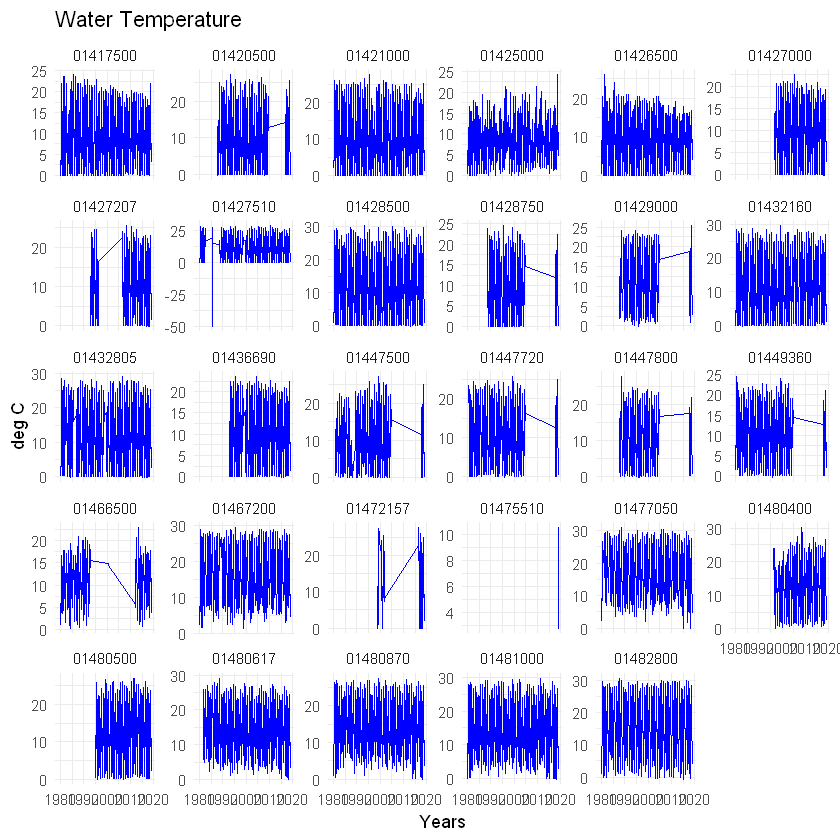

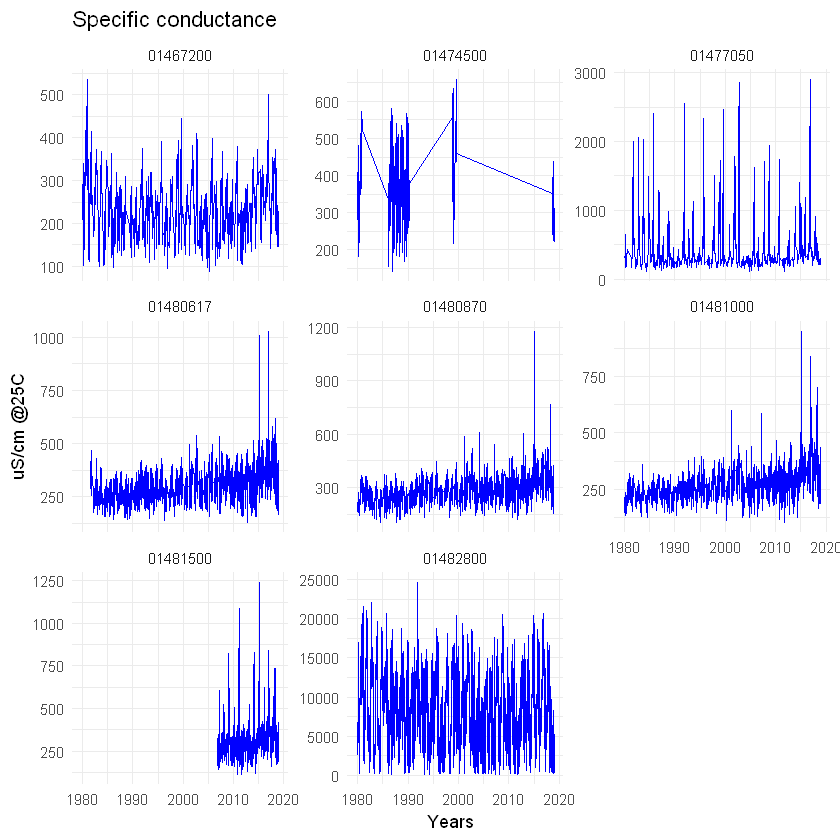

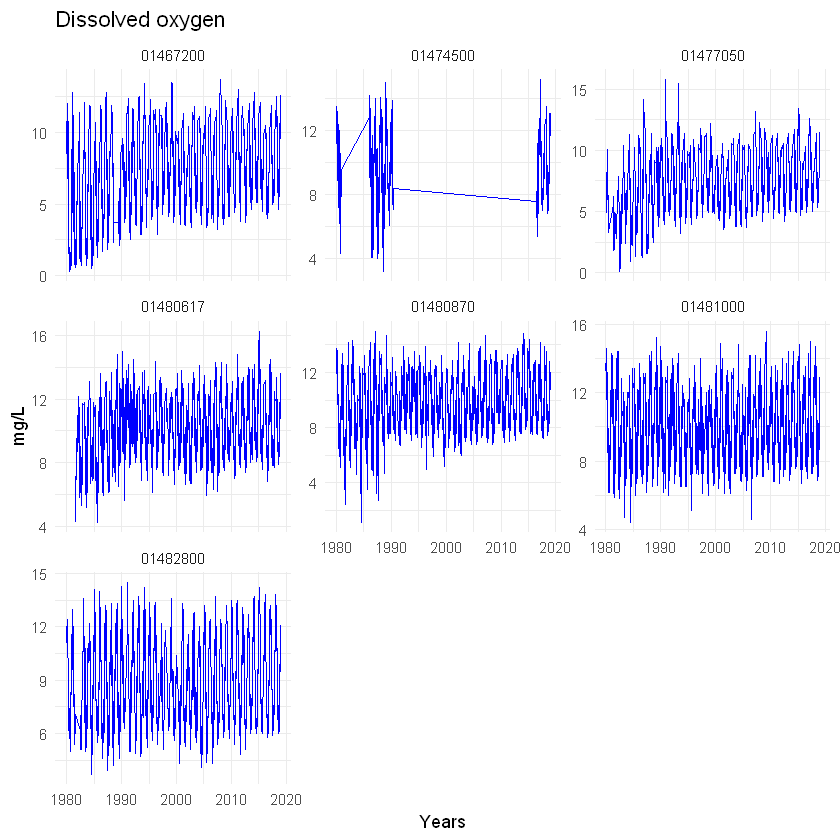

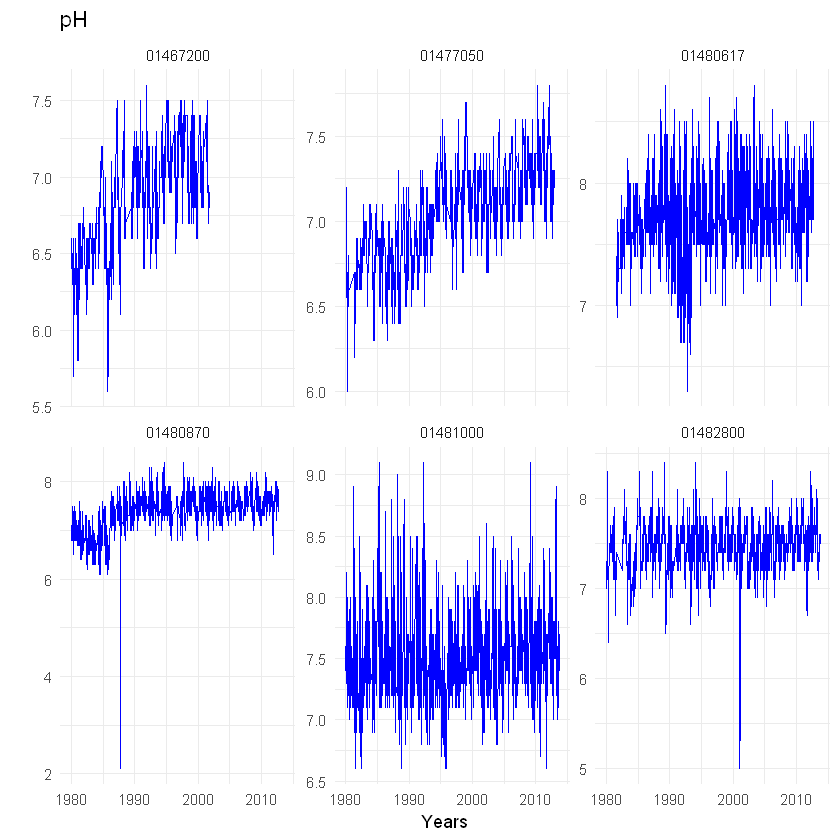

In [127]:
pCode_d = data.frame(parm_cd = c('00010','00095','00300','00400','00530','00602','00681','00618'),
                     name = c('Water Temperature','Specific conductance','Dissolved oxygen','pH','Total suspended solids',
                              'Total nitrogen','DOC','Nitrate'),
                    units = c('deg C','uS/cm @25C','mg/L','','mg/L','mg/L','mg/L','mg/L'))

for(var in pCode_d$parm_cd){
dd = pCode_d %>% filter(parm_cd==var)
df = dat_wq_daily %>% filter(!is.na(Val_mean)) %>% 
            filter(parm_cd==var)
    
#all_days = data.frame(dateTime = seq.Date(from = as.Date("1980-01-01"), to = as.Date("2019-01-01"), by = "day"))
#df_complete = left_join(all_days, df %>% mutate(dateTime = as.Date(dateTime)))

p =ggplot(df) +
geom_line(aes(dateTime,Val_mean),color = "blue")+
 theme_minimal() + #theme(axis.text.x = element_text(angle = 90, hjust = 1))+
    ggtitle(paste0(dd$name))+xlab('Years')+ylab(paste0(dd$units))+
    facet_wrap(~site_no,scales="free_y")
    
 print(p)
#as_widget(ggplotly(p))

}

In [107]:
dat_wq_daily %>% filter(parm_cd=="00010" & Val_mean<=-40)

parm_cd,site_no,dateTime,Val_max,Val_max_cd,Val_min,Val_min_cd,Val_mean,Val_mean_cd
00010,01427510,1985-06-29,-50,A,-50,A,-50,A
00010,01427510,1985-06-30,-50,A,-50,A,-50,A
00010,01427510,1985-07-01,-50,A,-50,A,-50,A


**Water Quality data from WQP**

In [95]:
rr<- function(s,p){
    print(p)
   return(readNWISqw(siteNumber = s, parameterCd = p, startDate  = "1980-01-01",  endDate = "2019-01-01"))
}

dat_wq_nwis = sites %>% select(site_no,parm_cd) %>% filter(!parm_cd %in% c(unique(dat_wq_daily$parm_cd),"63680"))%>%
          group_by(parm_cd) %>% 
do(rr(s = .$site_no, p = .$parm_cd))

[1] "00065" "00065"
 [1] "00530" "00530" "00530" "00530" "00530" "00530" "00530" "00530" "00530"
[10] "00530" "00530" "00530" "00530" "00530" "00530" "00530" "00530" "00530"
[19] "00530" "00530" "00530" "00530" "00530" "00530" "00530" "00530" "00530"
[28] "00530"
 [1] "00602" "00602" "00602" "00602" "00602" "00602" "00602" "00602" "00602"
[10] "00602" "00602" "00602" "00602" "00602" "00602" "00602" "00602" "00602"
[19] "00602" "00602" "00602" "00602" "00602" "00602" "00602" "00602" "00602"
[28] "00602" "00602"
[1] "00618" "00618" "00618" "00618" "00618"
 [1] "00665" "00665" "00665" "00665" "00665" "00665" "00665" "00665" "00665"
[10] "00665" "00665" "00665" "00665" "00665" "00665" "00665" "00665" "00665"
[19] "00665" "00665" "00665" "00665" "00665" "00665" "00665" "00665" "00665"
[28] "00665"
 [1] "00681" "00681" "00681" "00681" "00681" "00681" "00681" "00681" "00681"
[10] "00681" "00681" "00681" "00681" "00681" "00681" "00681" "00681" "00681"
[19] "00681" "00681" "00681" "00681" "0068

In [132]:
colnames(dat_wq_nwis)

[1] "agency_cd"                  "site_no"                   
 [3] "sample_dt"                  "sample_tm"                 
 [5] "sample_end_dt"              "sample_end_tm"             
 [7] "sample_start_time_datum_cd" "tm_datum_rlbty_cd"         
 [9] "coll_ent_cd"                "medium_cd"                 
[11] "project_cd"                 "aqfr_cd"                   
[13] "tu_id"                      "body_part_id"              
[15] "hyd_cond_cd"                "samp_type_cd"              
[17] "hyd_event_cd"               "sample_lab_cm_tx"          
[19] "parm_cd"                    "remark_cd"                 
[21] "result_va"                  "val_qual_tx"               
[23] "meth_cd"                    "dqi_cd"                    
[25] "rpt_lev_va"                 "rpt_lev_cd"                
[27] "lab_std_va"                 "prep_set_no"               
[29] "prep_dt"                    "anl_set_no"                
[31] "anl_dt"                     "result_lab_cm_tx"          
[33] "anl_ent_cd"                 "startDateTime"

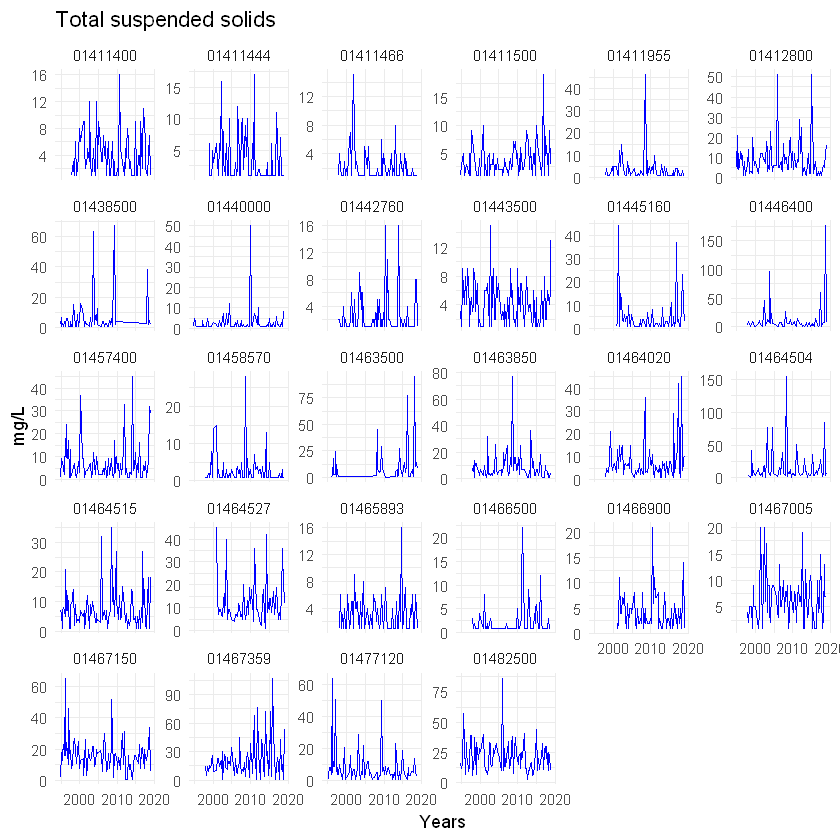

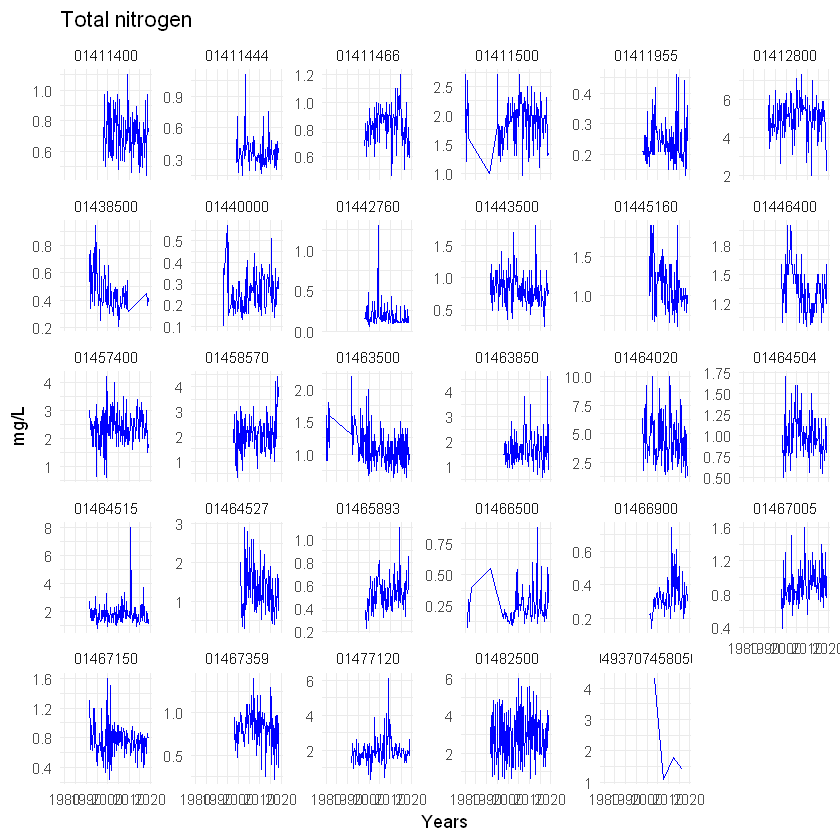

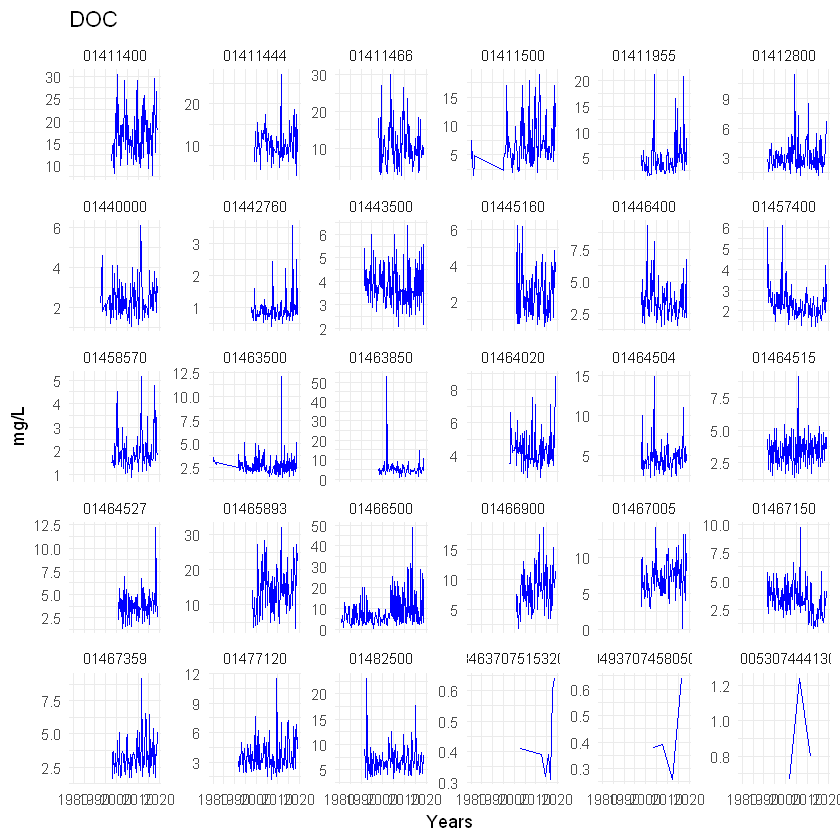

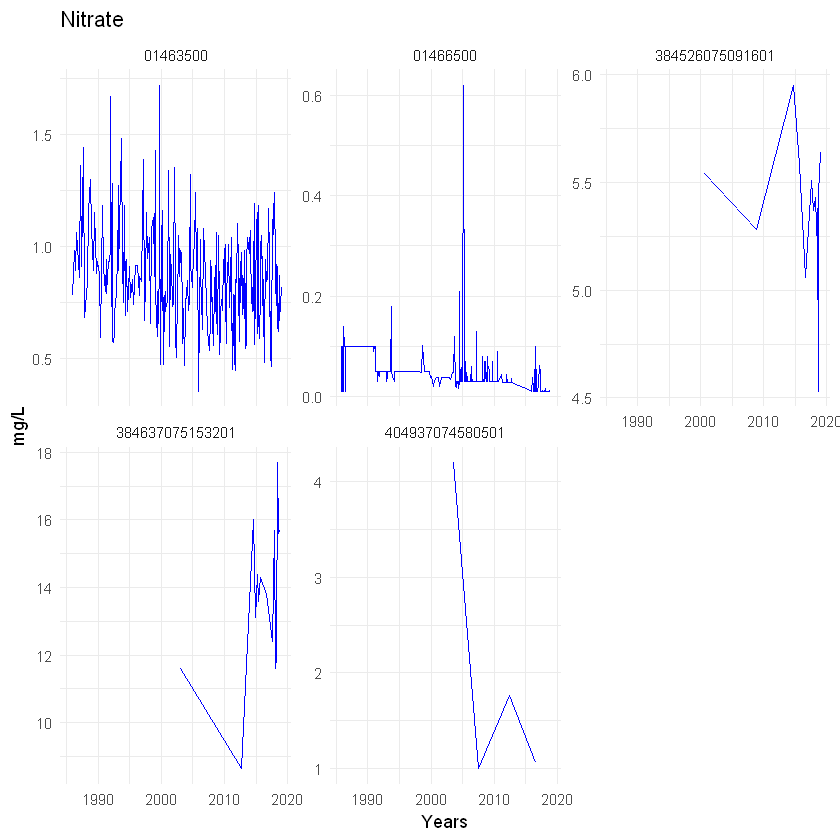

In [134]:
pCode_d = data.frame(parm_cd = c('00530','00602','00681','00618'),
                     name = c('Total suspended solids',
                              'Total nitrogen','DOC','Nitrate'),
                    units = c('mg/L','mg/L','mg/L','mg/L'))

for(var in pCode_d$parm_c){
dd = pCode_d %>% filter(parm_cd==var)
df = dat_wq_nwis %>% filter(!is.na(result_va)) %>% 
            filter(parm_cd==var) 
p =ggplot(df) +
geom_line(aes(startDateTime,result_va),color = "blue")+
 theme_minimal() + #theme(axis.text.x = element_text(angle = 90, hjust = 1))+
    ggtitle(paste0(dd$name))+xlab('Years')+ylab(paste0(dd$units))+
    facet_wrap(~site_no,scales="free_y")
    
 print(p)
#as_widget(ggplotly(p))

}
    

In [93]:
#dat_wqp= sites %>% select(agency_cd,site_no,parm_cd,begin_date) %>% 
        #  group_by(parm_cd) %>% do(readWQPqw(siteNumbers = paste0("USGS-",.$site_no), parameterCd = .$parm_cd, startDate = .$begin_date[1])) 
                  
#df = dat_wqp %>% select(ProviderName,USGSPCode,CharacteristicName,
              #     MonitoringLocationIdentifier,ActivityStartDate,ResultMeasureValue,ResultMeasure.MeasureUnitCode)

#write.csv(df,"WQP_DRB.csv")

**Box-plot of WQP Data**

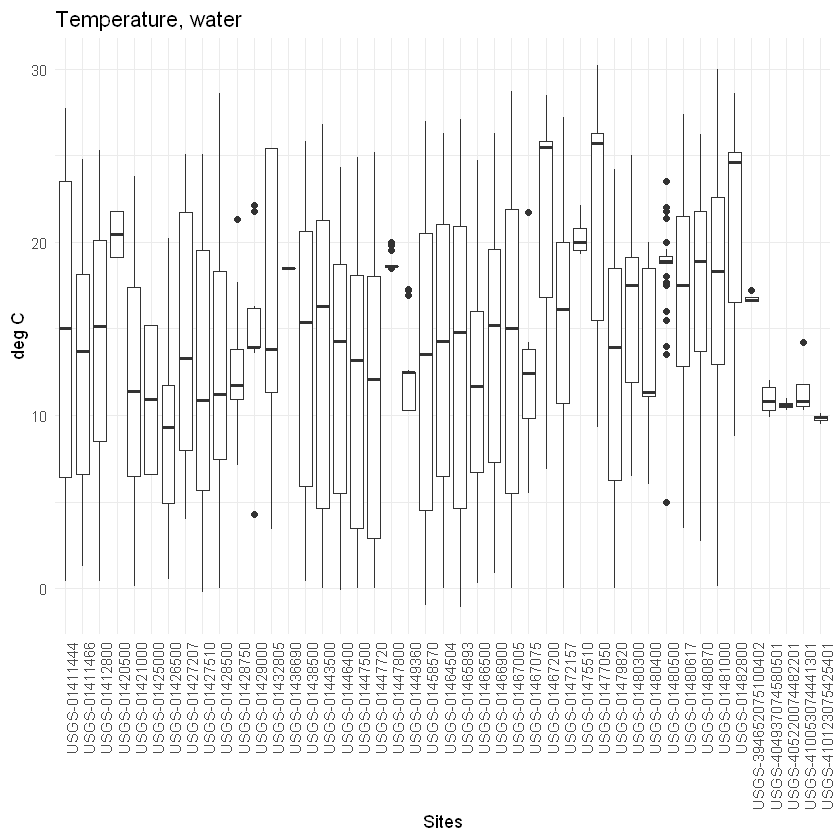

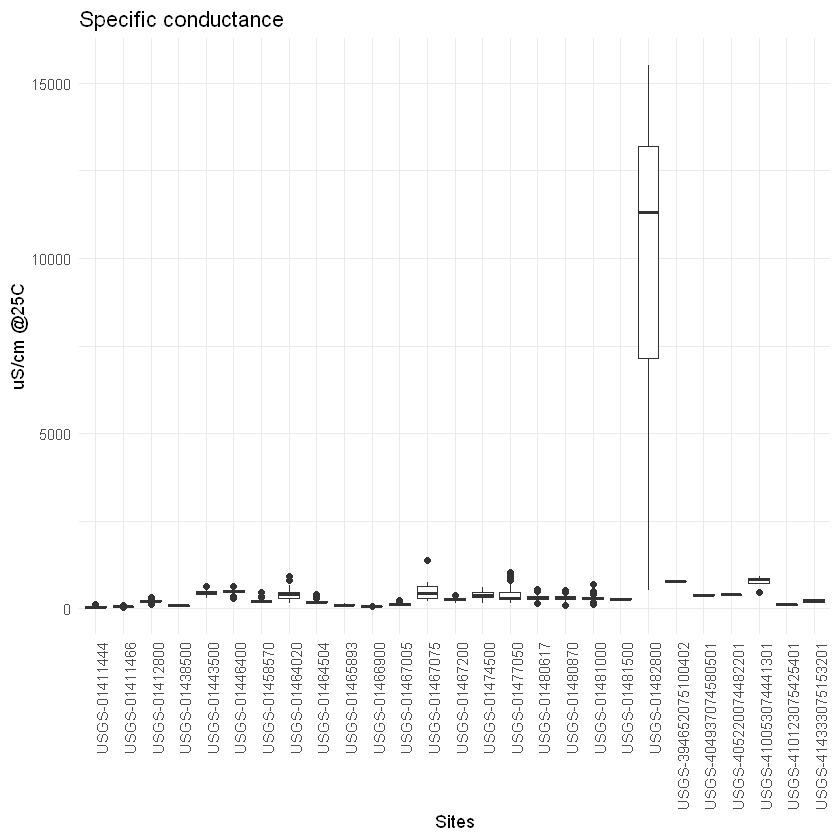

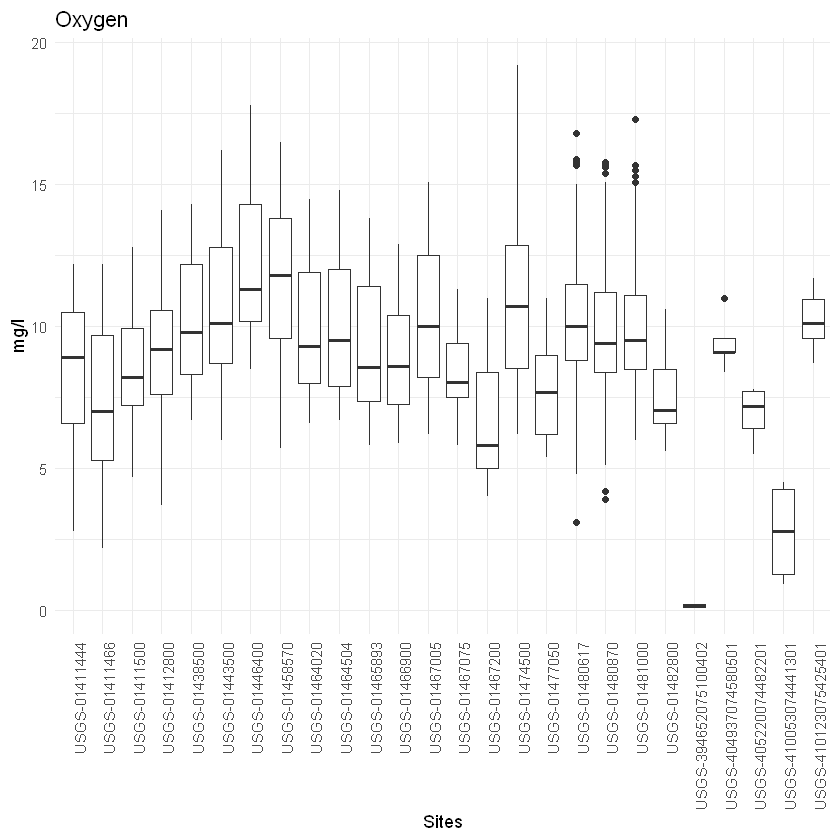

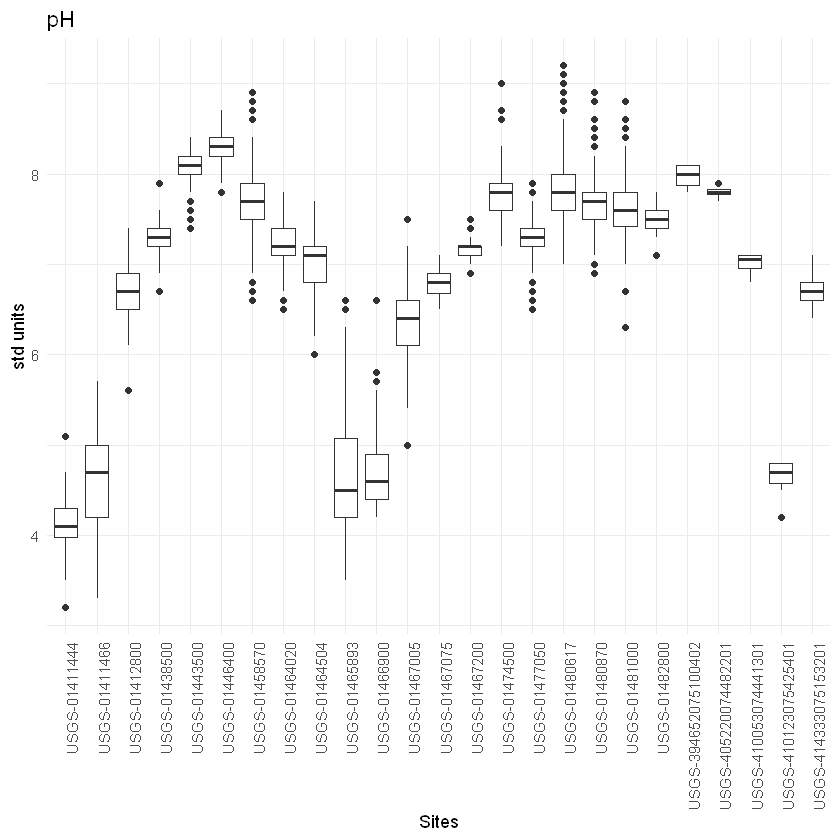

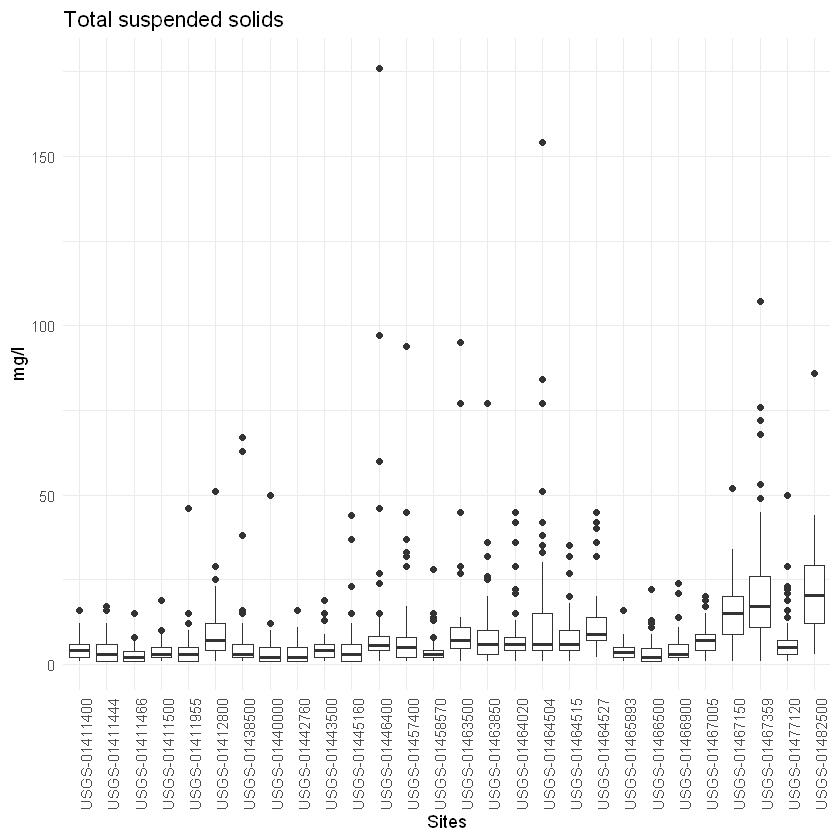

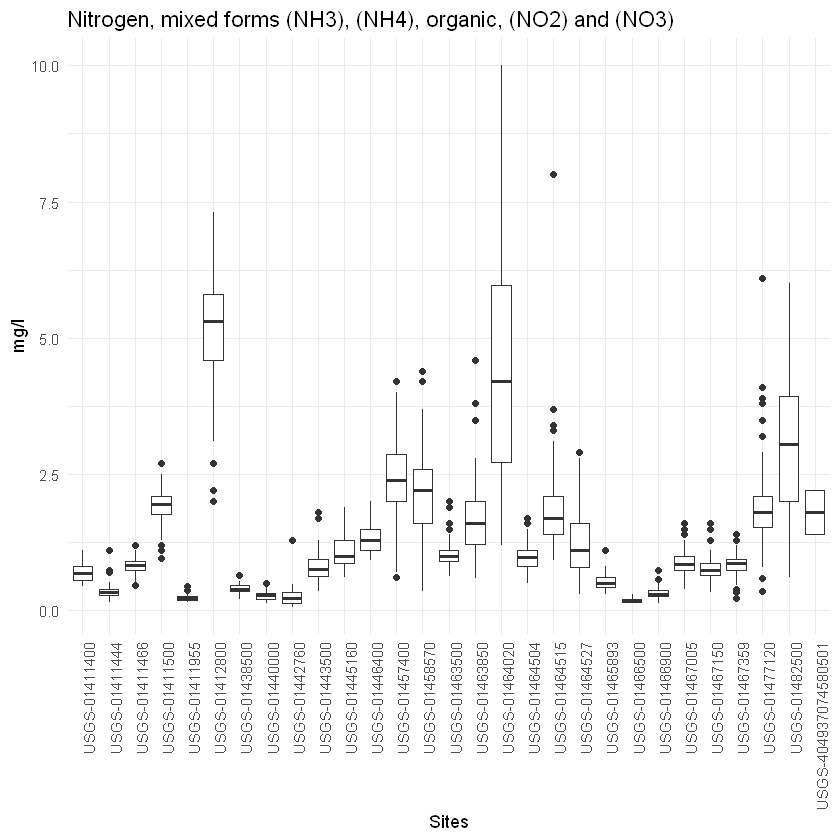

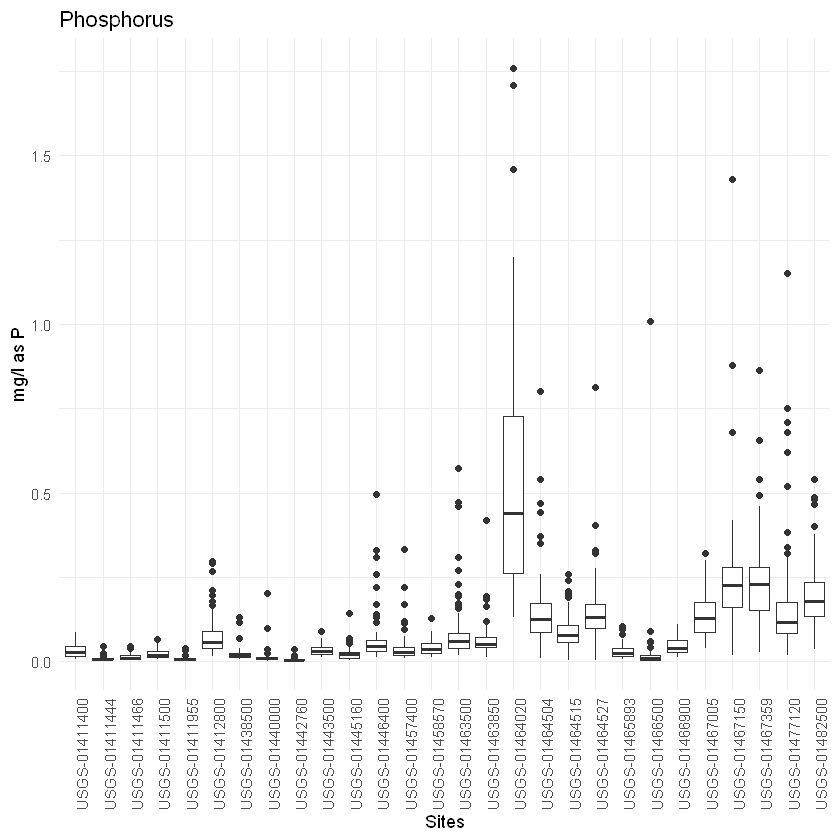

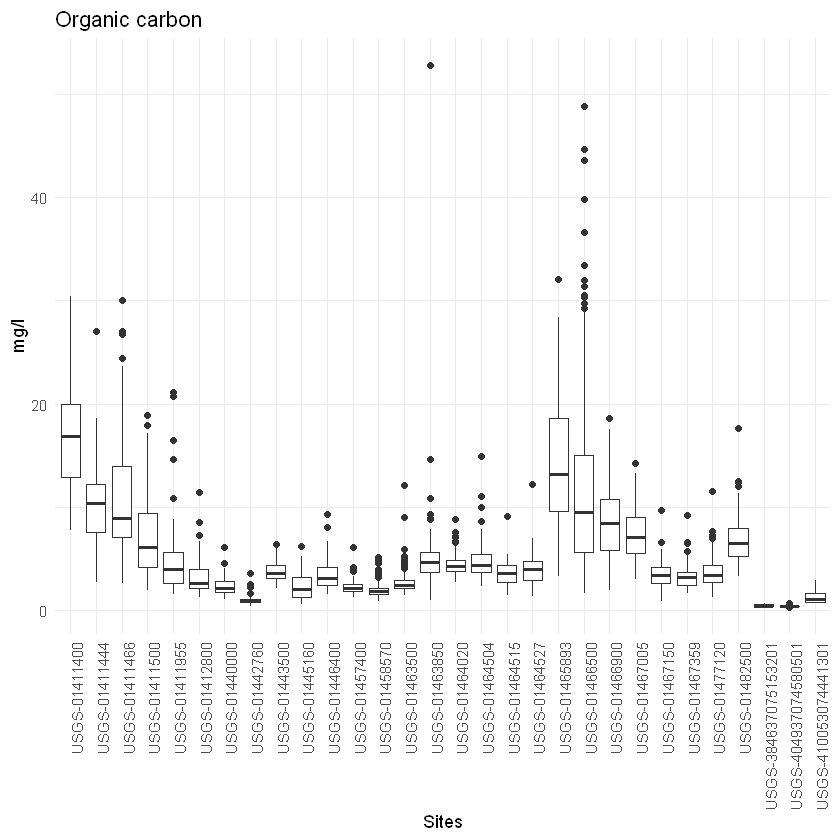

In [165]:
for(var in unique(dat_wqp$CharacteristicName)){
df = dat_wqp %>% filter(!is.na(ResultMeasureValue) & !is.na(ActivityStartDateTime)) %>% 
            filter(CharacteristicName==var)
p =ggplot(df) +
geom_boxplot(aes(MonitoringLocationIdentifier,ResultMeasureValue))+
 theme_minimal() + theme(axis.text.x = element_text(angle = 90, hjust = 1))+
    ggtitle(paste0(unique(df$CharacteristicName[1])))+xlab('Sites')+ylab(paste0(df$ResultMeasure.MeasureUnitCode[1]))
    
 print(p)
#as_widget(ggplotly(p))

}





**Summary of WQP data**

In [194]:
wqp_summary_stat <- dat_wqp %>%
  filter(!is.na(ResultMeasureValue) & !is.na(ActivityStartDateTime)) %>%
  group_by(USGSPCode,MonitoringLocationIdentifier) %>%
  summarise(count=n(),
            start=min(ActivityStartDateTime, na.rm = TRUE),
            end=max(ActivityStartDateTime, na.rm = TRUE),
            max = max(ResultMeasureValue, na.rm = TRUE),
           mean = mean(ResultMeasureValue, na.rm = TRUE),
            median = median(ResultMeasureValue, na.rm = TRUE),
           min = min(ResultMeasureValue, na.rm = TRUE),
           unit =ResultMeasure.MeasureUnitCode[1],
           name = CharacteristicName[1]) %>%
  filter(count >= 1) %>%
  arrange(USGSPCode,-count) 

write.csv(wqp_summary_stat, "WQP_stat.csv")


**Plot Maps**

In [9]:
addLegendCustom <- function(map, colors, labels, sizes, shapes, borders, opacity = 0.8){

            make_shapes <- function(colors, sizes, borders, shapes) {
                shapes <- gsub("circle", "50%", shapes)
                shapes <- gsub("square", "0%", shapes)
                paste0(colors, "; width:", sizes, "px; height:", sizes, "px; border:3px solid ", borders, "; border-radius:", shapes)
            }
            make_labels <- function(sizes, labels) {
                paste0("<div style='display: inline-block;height: ", 
                       sizes, "px;margin-top: 4px;line-height: ", 
                       sizes, "px;'>", labels, "</div>")
            }

            legend_colors <- make_shapes(colors, sizes, borders, shapes)
            legend_labels <- make_labels(sizes, labels)

            return(addLegend(map, colors = legend_colors, labels = legend_labels, opacity = opacity, title = "Site Type"))
        }


colors <- c("white", "darkblue")
        labels <- c("well", "stream/river")
        sizes <- c(10, 10)
        shapes <- c("circle", "circle")
        borders <- c("darkblue","darkblue")

col_types <- c("darkblue","dodgerblue","green4","gold1","orange","brown","red")

          
#wqp_summary_stat = wqp_summary_stat %>% 
#left_join(sites %>% select(site_no,dec_lat_va,dec_long_va) %>% mutate(MonitoringLocationIdentifier = paste0('USGS-',site_no)))

plot_map = function(df){
leg_vals = unique(as.numeric(quantile(df$mean, probs=c(0,0.01,0.1,0.25,0.5,0.75,0.9,.99,1), na.rm=TRUE)))
pal = colorBin(col_types, df$mean, bins = leg_vals)
rad = 3*seq(1,4,length.out = 16)
df$sizes <- rad[as.numeric(cut(df$count, breaks=16))]


  m = leaflet(data=df) %>% 
  setView(lng = -75.1, lat = 40.8, zoom = 7) %>%
  addProviderTiles("CartoDB.Positron") %>%
  addPolylines(data=basin_b, weight=2, col= 'black') %>%
  addCircleMarkers(~dec_long_va,~dec_lat_va,
                   fillColor = ~pal(mean),radius = ~sizes,#fillOpacity = ~ifelse(type == "gw", 0, 0.8), 
                   stroke=T, opacity = 1,color = ~pal(mean), weight = 1,
                   popup= paste(#"station:", wqp_summary_stat$station_nm, "<br>",
                                "id:", df$site_no, "<br>",
                               "count:", df$count,  "<br>",
                               "maximum:", df$max,  "<br>",
                                "median:", df$median, "<br>",
                                "mean:", df$mean,  "<br>",
                                "minimum:", df$min)) %>%
  addLegend(position = 'bottomleft',
            pal=pal,
            values=~max,
            opacity = 0.8,
            labFormat = labelFormat(digits = 1), 
            title = paste0('Mean Value (1980~2018) <br>', '(',unique(df$name[1]), '-', unique(df$unit[1]), ')' )) %>%
  addLegendCustom(colors, labels, sizes, shapes, borders)
    m
    }

In [11]:
#wqp_summary_stat = wqp_summary_stat %>% 
#left_join(sites %>% select(site_no,dec_lat_va,dec_long_va) %>% mutate(MonitoringLocationIdentifier = paste0('USGS-',site_no)))
wqp_summary_stat = wqp_summary_stat %>% 
left_join(sites %>% select(site_no,dec_lat_va,dec_long_va) %>% mutate(MonitoringLocationIdentifier = paste0('USGS-',site_no)))


Joining, by = "MonitoringLocationIdentifier"
Warning message:
"Column `MonitoringLocationIdentifier` joining factor and character vector, coercing into character vector"

In [7]:
wqp_summary_stat = read.csv('WQP_stat.csv')

**Nitrogen, mixed forms (NH3), (NH4), organic, (NO2) and (NO3)**

In [12]:
plot_map(wqp_summary_stat %>% filter(name=='Nitrogen, mixed forms (NH3), (NH4), organic, (NO2) and (NO3)'))

HTML widgets cannot be represented in plain text (need html)

**Organic carbon**

In [13]:
plot_map(wqp_summary_stat %>% filter(name=='Organic carbon'))

HTML widgets cannot be represented in plain text (need html)

**Phosphorus**

In [14]:
plot_map(wqp_summary_stat %>% filter(name=='Phosphorus'))

HTML widgets cannot be represented in plain text (need html)

**Total suspended solids**

In [15]:
plot_map(wqp_summary_stat %>% filter(name=='Total suspended solids'))

HTML widgets cannot be represented in plain text (need html)

**pH**

In [16]:
plot_map(wqp_summary_stat %>% filter(name=='pH'))

HTML widgets cannot be represented in plain text (need html)

**Oxygen**

In [17]:
plot_map(wqp_summary_stat %>% filter(name=='Oxygen'))

HTML widgets cannot be represented in plain text (need html)

**Temperature, water**

In [18]:
plot_map(wqp_summary_stat %>% filter(name=='Temperature, water'))

HTML widgets cannot be represented in plain text (need html)

**Specific conductance**

In [19]:
plot_map(wqp_summary_stat %>% filter(name=='Specific conductance'))

HTML widgets cannot be represented in plain text (need html)

In [143]:
siteNo <- c('01463500', '01434000','01427510','01427207','01467200','01442500','01481000')
pCode <- c('00530','00602','00300','00010','00530','00665')


          # pCode_d = data.frame(parm_cd = c('00010','00300','00400','00530','00602','00681','00618'),
                 #    name = c('Water Temperature','Dissolved oxygen','pH','Total suspended solids',
                 #             'Total nitrogen','DOC','Nitrate'),
                 #   units = c('deg C','uS/cm @25C','mg/L','','mg/L','mg/L','mg/L','mg/L'))

read_wq_daily<-function(sites,pc){
 df =readNWISdata(sites =sites, service = 'dv',parameterCd =pc,startDate = "1980-01-01",endDate = "2019-01-01") 
    print(pc)
    if(dim(df)[1]!=0){
       df= df %>% select_('site_no','dateTime',
        'Val_max'=paste0('X_',pc,'_00001'),'Val_max_cd'=paste0('X_',pc,'_00001_cd'),
        'Val_min'=paste0('X_',pc,'_00002'),'Val_min_cd'=paste0('X_',pc,'_00002_cd'),
        'Val_mean'=paste0('X_',pc,'_00003'),'Val_mean_cd'=paste0('X_',pc,'_00003_cd'))
        }
    return(df)
    }

dat_gage_daily= data.frame(parm_cd = pCode) %>% #filter(!parm_cd %in% c("00065","63680","00618"))%>% select(site_no,parm_cd) %>% 
group_by(parm_cd) %>% do(read_wq_daily(sites =siteNo, pc =as.character(.$parm_cd))) 

write.csv(dat_gage_daily,"daily_gage_DRB.csv")



[1] "00010"
[1] "00300"
[1] "00530" "00530"
[1] "00602"
[1] "00665"


[1] "00010"
[1] "00300"


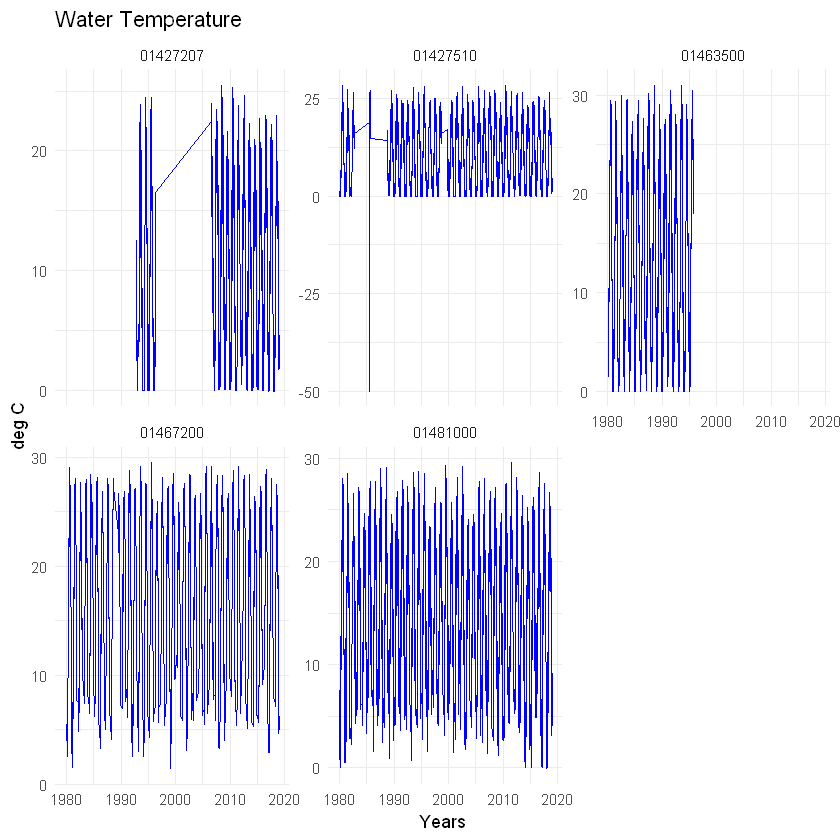

[1] "00530"


ERROR: Error: Faceting variables must have at least one value


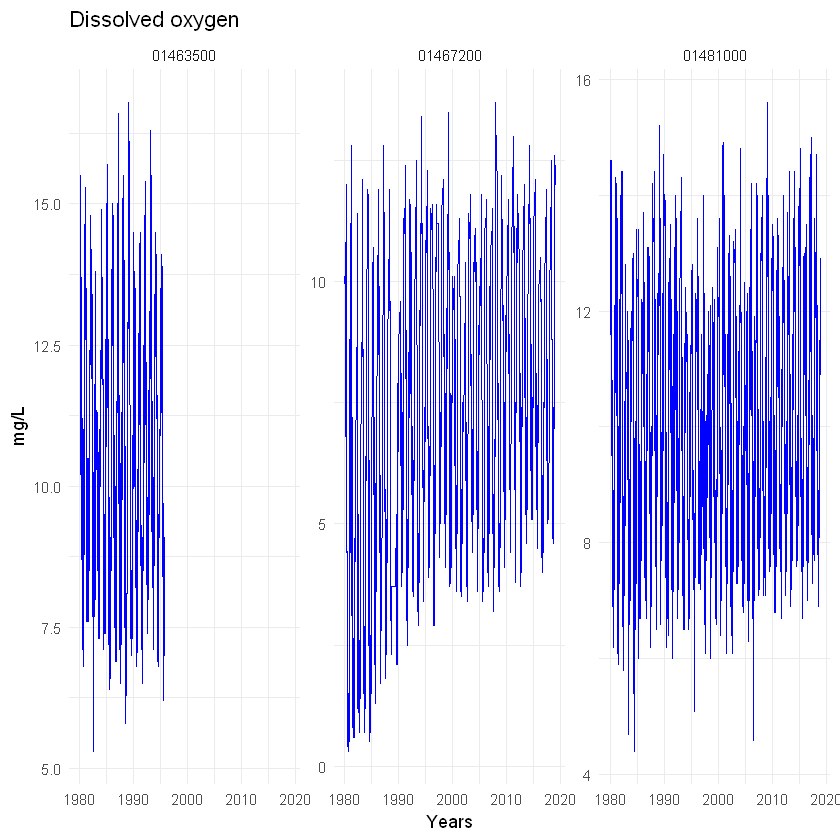

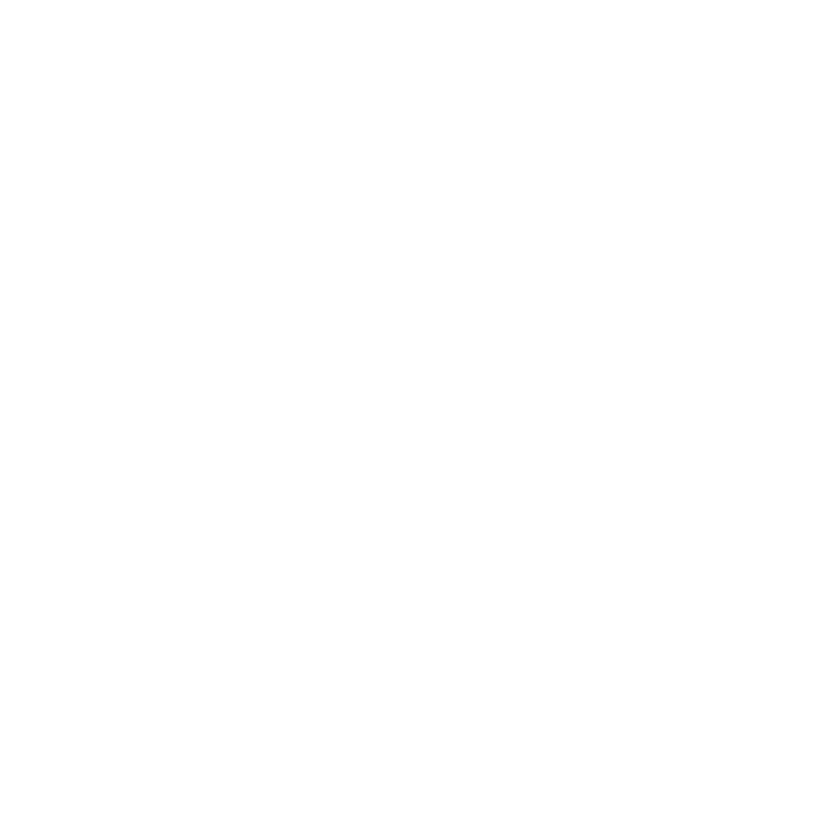

In [152]:
pCode_d = data.frame(parm_cd = c('00010','00300','00530','00602','00665'),
                     name = c('Water Temperature','Dissolved oxygen',
                              'Total suspended solids',
                              'Total nitrogen','Total Phosphorus'),
                    units = c('deg C','mg/L','mg/L','mg/L','mg/L'))

for(var in pCode_d$parm_cd){
    print(var)
dd = pCode_d %>% filter(parm_cd==var)
df = dat_gage_daily %>% filter(!is.na(Val_mean)) %>% 
            filter(parm_cd==var)
    
#all_days = data.frame(dateTime = seq.Date(from = as.Date("1980-01-01"), to = as.Date("2019-01-01"), by = "day"))
#df_complete = left_join(all_days, df %>% mutate(dateTime = as.Date(dateTime)))

p =ggplot(df) +
geom_line(aes(dateTime,Val_mean),color = "blue")+
 theme_minimal() + #theme(axis.text.x = element_text(angle = 90, hjust = 1))+
    ggtitle(paste0(dd$name))+xlab('Years')+ylab(paste0(dd$units))+
    facet_wrap(~site_no,scales="free_y")
    
 print(p)
#as_widget(ggplotly(p))

}

In [20]:
# Delaware River at Montage,NJ
read_wq_daily<-function(sites,pc){
 df =readNWISdata(sites =sites, service = 'dv',parameterCd =pc,startDate = "1980-01-01",endDate = "2019-01-01") 
    print(pc)
    if(dim(df)[1]!=0){
       df= df %>% select_('site_no','dateTime',
        'Val_max'=paste0('X_',pc,'_00001'),'Val_max_cd'=paste0('X_',pc,'_00001_cd'),
        'Val_min'=paste0('X_',pc,'_00002'),'Val_min_cd'=paste0('X_',pc,'_00002_cd'),
        'Val_mean'=paste0('X_',pc,'_00003'),'Val_mean_cd'=paste0('X_',pc,'_00003_cd'))
        }
    return(df)
    }
wq_gage_daily= data.frame(parm_cd = pCode) %>% #filter(!parm_cd %in% c("00065","63680","00618"))%>% select(site_no,parm_cd) %>% 
group_by(parm_cd) %>% do(read_wq_daily(sites ="01438500", pc =as.character(.$parm_cd))) 


[1] "00010"
[1] "00065"
[1] "00076"
[1] "00095"
[1] "00300"
[1] "00301"
[1] "00400"
[1] "00530"
[1] "00602"
[1] "00618"
[1] "00620"
[1] "00665"
[1] "00681"
[1] "63680"
[1] "72019"
[1] "99133"


Warning message:
"Factor `parm_cd` contains implicit NA, consider using `forcats::fct_explicit_na`"

parm_cd


In [ ]:
dis_gage_daily = readNWISdata(sites ='01438500', service = 'dv',parameterCd ='00060',startDate = "1980-01-01",endDate = "2019-01-01") 
